In [37]:
# hello world

For clean output

In [38]:
from IPython.display import clear_output

Imports

In [39]:
import os
import random
import numpy as np
from glob import glob
from PIL import Image, ImageOps

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, losses, optimizers, callbacks

AUTOTUNE = tf.data.AUTOTUNE


System config

In [40]:
SEED = 10
random.seed(SEED)
tf.random.set_seed(SEED)

IMAGE_SIZE = 256
MAX_TRAIN_IMAGES = 400  
BATCH_SIZE = 16

TRAIN_VAL_IMAGE_DIR = "data/lol_dataset/our485/low"
TEST_IMAGE_DIR = "data/lol_dataset/eval15/low"

LEARNING_RATE = 1e-4
LOG_INTERVALS = 10
EPOCHS = 40


Set the url for the image files

In [41]:
train_val_image_files = glob(os.path.join(TRAIN_VAL_IMAGE_DIR, "*.png"))
test_image_files = glob(os.path.join(TEST_IMAGE_DIR, "*.png"))

random.shuffle(train_val_image_files)

train_image_files = train_val_image_files[:MAX_TRAIN_IMAGES]
val_image_files = train_val_image_files[MAX_TRAIN_IMAGES:]

print("Number of Training Images:", len(train_image_files))
print("Number of Validation Images:", len(val_image_files))
print("Number of Test Images from LOL Dataset:", len(test_image_files))


Number of Training Images: 400
Number of Validation Images: 85
Number of Test Images from LOL Dataset: 15


Load the data

In [42]:
def load_data(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    image = image / 255.0
    return image


def get_dataset(images):
    dataset = tf.data.Dataset.from_tensor_slices((images))
    dataset = dataset.map(load_data, num_parallel_calls=AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    dataset = dataset.prefetch(AUTOTUNE)
    
    return dataset


train_dataset = get_dataset(train_image_files)
val_dataset = get_dataset(val_image_files)

In [43]:
print("\033[94m")
print("Train Data Elements:", train_dataset.element_spec)
print("Validation Data Elements:", val_dataset.element_spec)


Train Data Elements: TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)
Validation Data Elements: TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)


Check few images

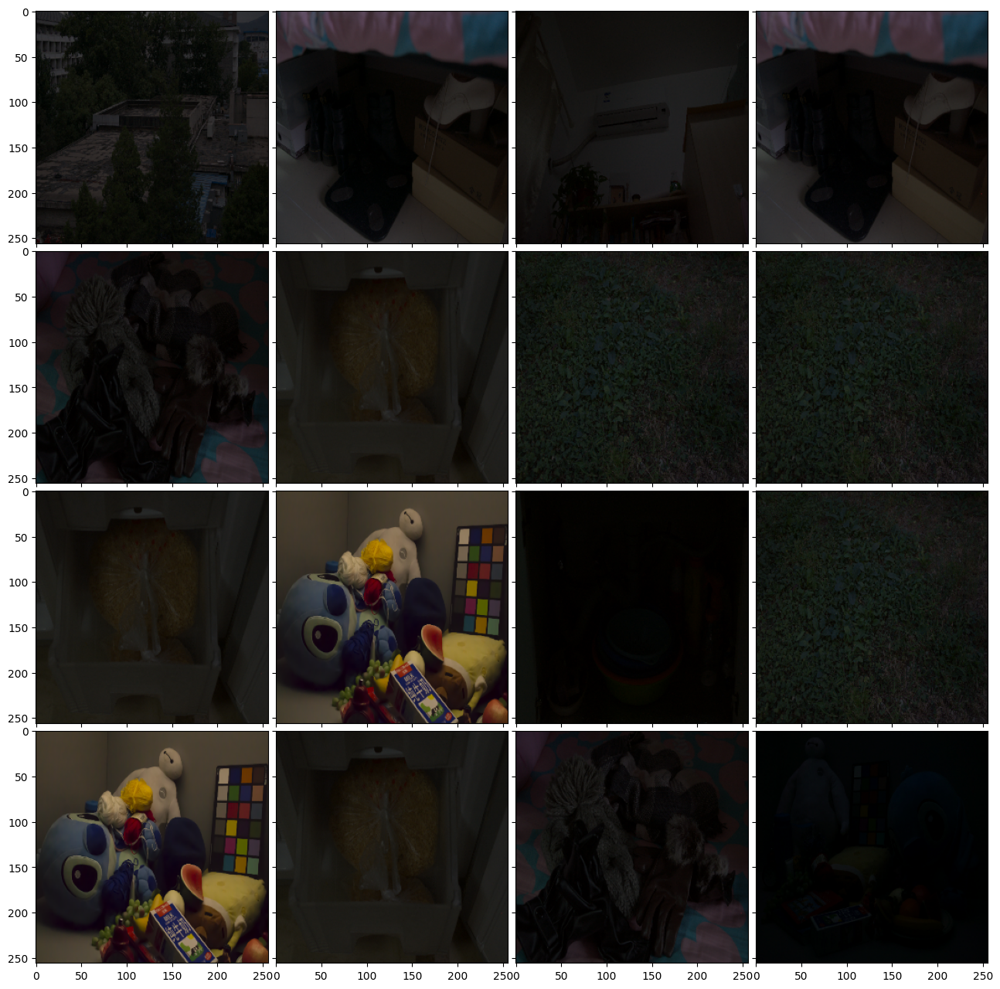

In [44]:
images = next(iter(train_dataset)).numpy()

fig = plt.figure(figsize=(16, 16))
grid = ImageGrid(fig, 111, nrows_ncols=(4, 4), axes_pad=0.1)

random_images = images[np.random.choice(np.arange(images.shape[0]), 16)]

for ax, image in zip(grid, random_images):
    image = image * 255.0
    ax.imshow(image.astype(np.uint8))

plt.title("Sample Training Images")
plt.show()

In [45]:
def build_dce_net(image_size=None) -> keras.Model:
    input_image = keras.Input(shape=[image_size, image_size, 3])

    conv1 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(input_image)

    conv2 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv1)

    conv3 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv2)

    conv4 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv3)

    int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])

    conv5 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con1)

    int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])

    conv6 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con2)

    int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])

    x_r = layers.Conv2D(
        24, (3, 3), strides=(1, 1), activation="tanh", padding="same"
    )(int_con3)

    return keras.Model(inputs=input_image, outputs=x_r)


In [46]:
def color_constancy_loss(x):
    mean_rgb = tf.reduce_mean(x, axis=(1, 2), keepdims=True)
    mean_red = mean_rgb[:, :, :, 0]
    mean_green = mean_rgb[:, :, :, 1]
    mean_blue = mean_rgb[:, :, :, 2]

    diff_red_green = tf.square(mean_red - mean_green)
    diff_red_blue = tf.square(mean_red - mean_blue)
    diff_green_blue = tf.square(mean_blue - mean_green)

    return tf.sqrt(
        tf.square(diff_red_green) +
        tf.square(diff_red_blue) +
        tf.square(diff_green_blue)
    )


In [47]:
def exposure_loss(x, mean_val=0.6):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))

In [48]:
def illumination_smoothness_loss(x):
    """Inspired from https://github.com/tuvovan/Zero_DCE_TF/blob/master/src/loss.py#L28"""
    batch_size = tf.shape(x)[0]
    height_x = tf.shape(x)[1]
    width_x = tf.shape(x)[2]
    count_height = (tf.shape(x)[2] - 1) * tf.shape(x)[3]
    count_width = tf.shape(x)[2] * (tf.shape(x)[3] - 1)
    height_total_variance = tf.reduce_sum(
        tf.square((x[:, 1:, :, :] - x[:, : height_x - 1, :, :]))
    )
    width_total_variance = tf.reduce_sum(
        tf.square((x[:, :, 1:, :] - x[:, :, : width_x - 1, :]))
    )
    batch_size = tf.cast(batch_size, dtype=tf.float32)
    count_height = tf.cast(count_height, dtype=tf.float32)
    count_width = tf.cast(count_width, dtype=tf.float32)
    return 2 * (
        height_total_variance / count_height + width_total_variance / count_width
    ) / batch_size

In [49]:
class SpatialConsistencyLoss(losses.Loss):
    def __init__(self, **kwargs):
        super(SpatialConsistencyLoss, self).__init__(reduction="none")

        self.left_kernel = tf.constant(
            [[[[0, 0, 0]], [[-1, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.right_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, -1]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.up_kernel = tf.constant(
            [[[[0, -1, 0]], [[0, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.down_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, 0]], [[0, -1, 0]]]], dtype=tf.float32
        )

    def call(self, y_true, y_pred):

        original_mean = tf.reduce_mean(y_true, 3, keepdims=True)
        enhanced_mean = tf.reduce_mean(y_pred, 3, keepdims=True)
        original_pool = tf.nn.avg_pool2d(
            original_mean, ksize=4, strides=4, padding="VALID"
        )
        enhanced_pool = tf.nn.avg_pool2d(
            enhanced_mean, ksize=4, strides=4, padding="VALID"
        )

        d_original_left = tf.nn.conv2d(
            original_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_right = tf.nn.conv2d(
            original_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_up = tf.nn.conv2d(
            original_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_down = tf.nn.conv2d(
            original_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_enhanced_left = tf.nn.conv2d(
            enhanced_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_right = tf.nn.conv2d(
            enhanced_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_up = tf.nn.conv2d(
            enhanced_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_down = tf.nn.conv2d(
            enhanced_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_left = tf.square(d_original_left - d_enhanced_left)
        d_right = tf.square(d_original_right - d_enhanced_right)
        d_up = tf.square(d_original_up - d_enhanced_up)
        d_down = tf.square(d_original_down - d_enhanced_down)
        return d_left + d_right + d_up + d_down

In [50]:
class ZeroDCE(keras.Model):
    def __init__(self, **kwargs):
        super(ZeroDCE, self).__init__(**kwargs)
        self.dce_model = build_dce_net(IMAGE_SIZE)

    def compile(self, learning_rate, **kwargs):
        super(ZeroDCE, self).compile(**kwargs)
        self.optimizer = optimizers.Adam(learning_rate=learning_rate)
        self.spatial_constancy_loss = SpatialConsistencyLoss(reduction="none")
    
    def summary(self, *args, **kwargs):
        self.dce_model.summary(*args, **kwargs)

    def get_enhanced_image(self, data, output):
        x = data
        for i in range(0, 3 * 8, 3):
            r = output[:, :, :, i: i + 3]
            x = x + r * (tf.square(x) - x)
        return x

    def call(self, data):
        dce_net_output = self.dce_model(data)
        return self.get_enhanced_image(data, dce_net_output)

    def compute_losses(self, data, output):
        enhanced_image = self.get_enhanced_image(data, output)

        loss_illumination = 200 * illumination_smoothness_loss(output)

        loss_spatial_constancy = tf.reduce_mean(
            self.spatial_constancy_loss(enhanced_image, data)
        )

        loss_color_constancy = 5 * tf.reduce_mean(
            color_constancy_loss(enhanced_image)
        )

        loss_exposure = 10 * tf.reduce_mean(
            exposure_loss(enhanced_image)
        )

        total_loss = (
            loss_illumination
            + loss_spatial_constancy
            + loss_color_constancy
            + loss_exposure
        )

        return {
            "total_loss": total_loss,
            "illumination_smoothness_loss": loss_illumination,
            "spatial_constancy_loss": loss_spatial_constancy,
            "color_constancy_loss": loss_color_constancy,
            "exposure_loss": loss_exposure,
        }

    def train_step(self, data):
        with tf.GradientTape() as tape:
            output = self.dce_model(data)
            losses = self.compute_losses(data, output)

        gradients = tape.gradient(
            losses["total_loss"],
            self.dce_model.trainable_weights
        )

        self.optimizer.apply_gradients(
            zip(gradients, self.dce_model.trainable_weights)
        )

        return losses

    def test_step(self, data):
        output = self.dce_model(data)
        return self.compute_losses(data, output)

    def save_weights(self, filepath, overwrite=True, save_format=None, options=None):
        self.dce_model.save_weights(
            filepath, overwrite=overwrite,
            save_format=save_format, options=options
        )

    def load_weights(self, filepath, by_name=False, skip_mismatch=False, options=None):
        self.dce_model.load_weights(
            filepath=filepath,
            by_name=by_name,
            skip_mismatch=skip_mismatch,
            options=options,
        )


In [51]:
zero_dce_model = ZeroDCE()
zero_dce_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d_14 (Conv2D)          (None, 256, 256, 32)         896       ['input_3[0][0]']             
                                                                                                  
 conv2d_15 (Conv2D)          (None, 256, 256, 32)         9248      ['conv2d_14[0][0]']           
                                                                                                  
 conv2d_16 (Conv2D)          (None, 256, 256, 32)         9248      ['conv2d_15[0][0]']           
                                                                                            

In [52]:
def plot_results(images, titles, figure_size=(12, 12)):
    fig = plt.figure(figsize=figure_size)
    for i in range(len(images)):
        fig.add_subplot(1, len(images), i + 1).set_title(titles[i])
        _ = plt.imshow(images[i])
        plt.axis("off")
    plt.show()


def infer(original_image):
    original_image = original_image.resize((IMAGE_SIZE, IMAGE_SIZE))

    image = keras.preprocessing.image.img_to_array(original_image)
    image = image[:, :, :3] if image.shape[-1] > 3 else image

    image = image.astype("float32") / 255.0
    image = np.expand_dims(image, axis=0)

    output_image = zero_dce_model(image, training=False)
    output_image = tf.cast(output_image[0] * 255, dtype=tf.uint8)

    output_image = Image.fromarray(output_image.numpy())
    return output_image



In [53]:
class LogPredictionCallback(callbacks.Callback):

    def __init__(self, image_files, log_interval, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.image_files = image_files
        self.log_interval = log_interval

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.log_interval == 0:
            for image_file in self.image_files:
                original_image = Image.open(image_file).convert("RGB")
                enhanced_image = infer(original_image)
                plot_results(
                    [original_image, enhanced_image],
                    ["Original", "Enhanced_Image"],
                    (15, 7),
                )


Epoch 1/40
25/25 [==============================] - ETA: 0s - total_loss: 4.7241 - illumination_smoothness_loss: 1.7992 - spatial_constancy_loss: 7.1028e-05 - color_constancy_loss: 0.0053 - exposure_loss: 2.9196

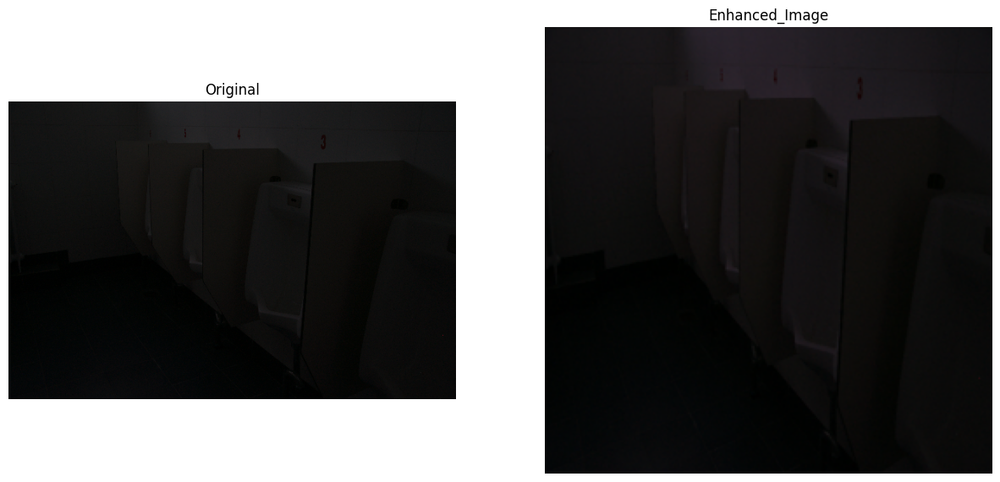

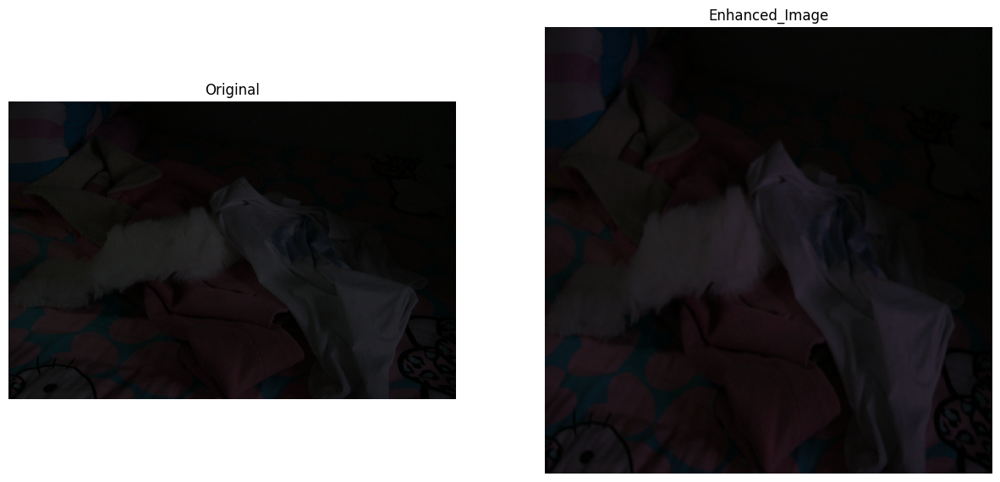

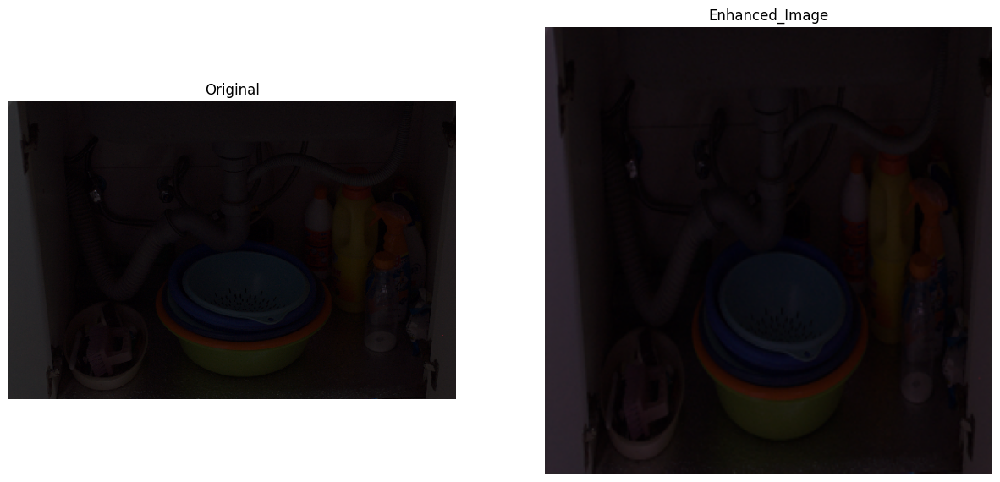

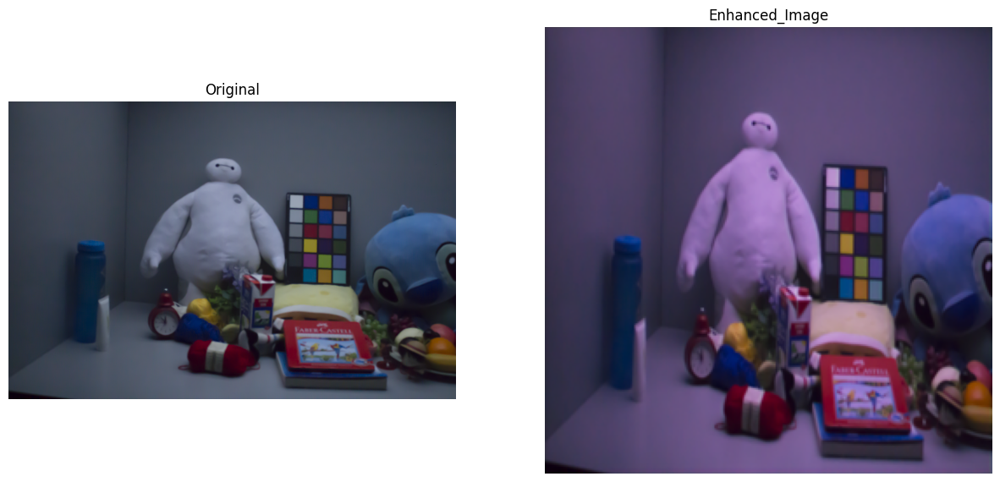

25/25 [==============================] - 120s 5s/step - total_loss: 4.7101 - illumination_smoothness_loss: 1.7878 - spatial_constancy_loss: 7.1019e-05 - color_constancy_loss: 0.0052 - exposure_loss: 2.9170 - val_total_loss: 3.6509 - val_illumination_smoothness_loss: 0.7492 - val_spatial_constancy_loss: 5.6396e-05 - val_color_constancy_loss: 0.0031 - val_exposure_loss: 2.8985
Epoch 2/40
25/25 [==============================] - 115s 5s/step - total_loss: 4.0070 - illumination_smoothness_loss: 1.0944 - spatial_constancy_loss: 7.5664e-05 - color_constancy_loss: 0.0036 - exposure_loss: 2.9088 - val_total_loss: 3.3462 - val_illumination_smoothness_loss: 0.4549 - val_spatial_constancy_loss: 6.5714e-05 - val_color_constancy_loss: 0.0023 - val_exposure_loss: 2.8889
Epoch 3/40
25/25 [==============================] - 115s 5s/step - total_loss: 3.6092 - illumination_smoothness_loss: 0.7091 - spatial_constancy_loss: 9.7540e-05 - color_constancy_loss: 0.0029 - exposure_loss: 2.8971 - val_total_loss

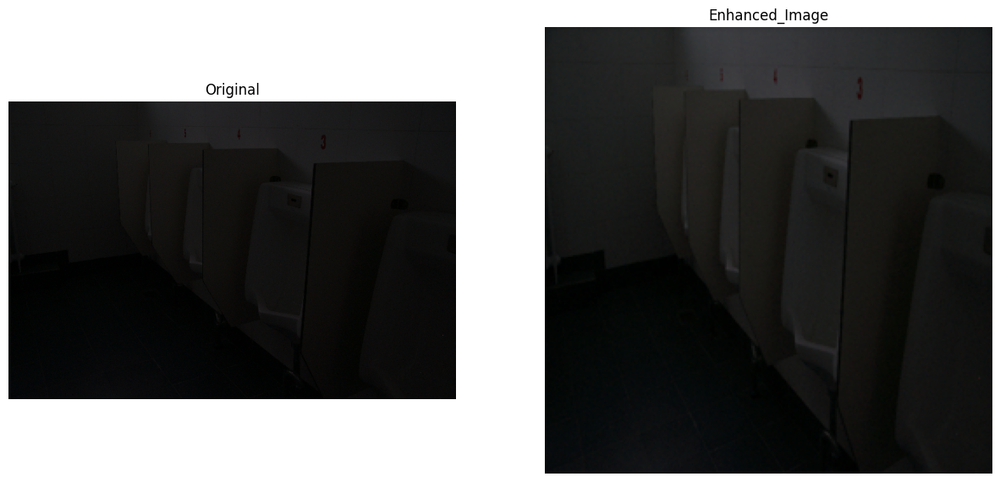

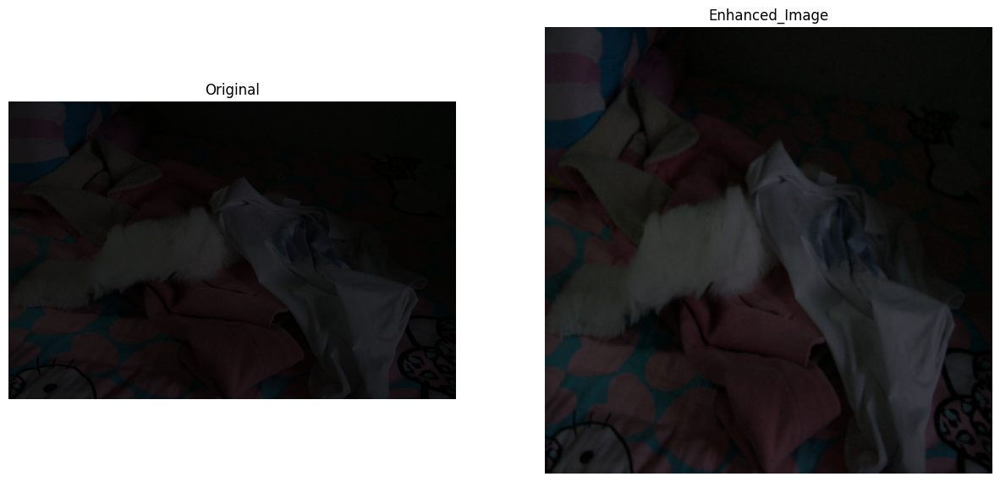

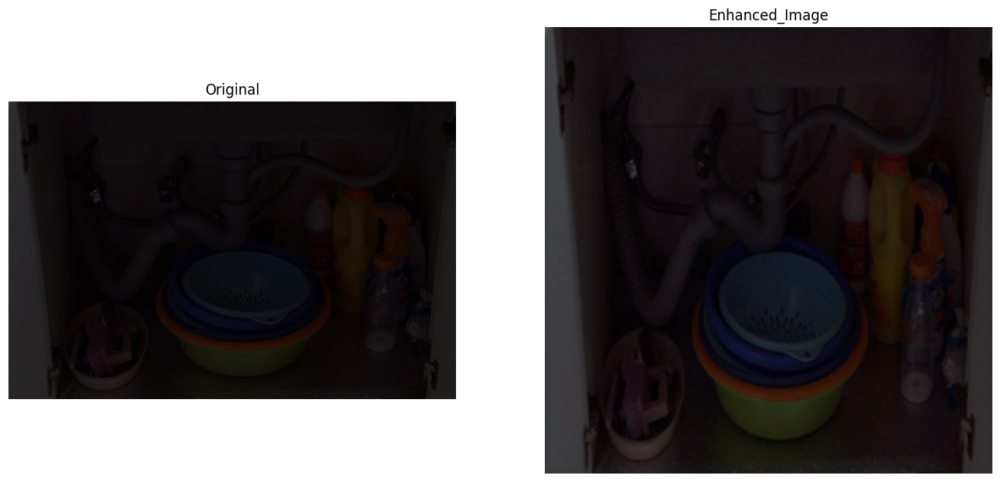

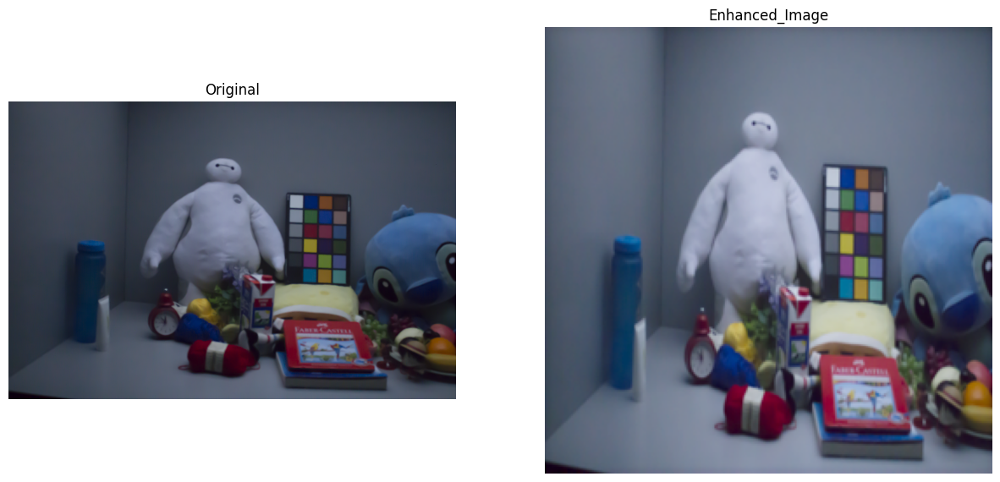

25/25 [==============================] - 114s 5s/step - total_loss: 2.8341 - illumination_smoothness_loss: 0.1771 - spatial_constancy_loss: 0.0024 - color_constancy_loss: 0.0048 - exposure_loss: 2.6498 - val_total_loss: 2.6916 - val_illumination_smoothness_loss: 0.1192 - val_spatial_constancy_loss: 0.0032 - val_color_constancy_loss: 0.0043 - val_exposure_loss: 2.5649
Epoch 12/40
25/25 [==============================] - 114s 5s/step - total_loss: 2.7107 - illumination_smoothness_loss: 0.1920 - spatial_constancy_loss: 0.0054 - color_constancy_loss: 0.0063 - exposure_loss: 2.5070 - val_total_loss: 2.4913 - val_illumination_smoothness_loss: 0.1396 - val_spatial_constancy_loss: 0.0086 - val_color_constancy_loss: 0.0065 - val_exposure_loss: 2.3366
Epoch 13/40
25/25 [==============================] - 114s 5s/step - total_loss: 2.3461 - illumination_smoothness_loss: 0.2469 - spatial_constancy_loss: 0.0250 - color_constancy_loss: 0.0137 - exposure_loss: 2.0605 - val_total_loss: 1.7890 - val_ill

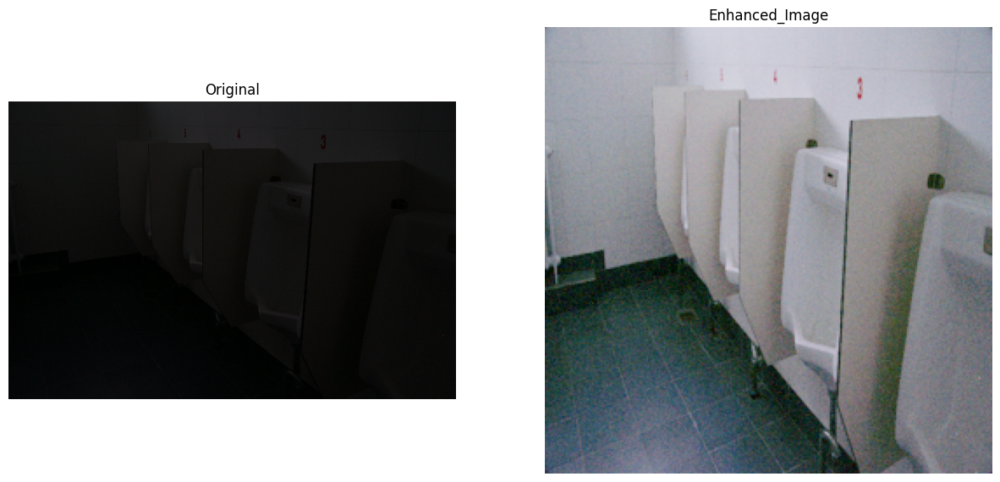

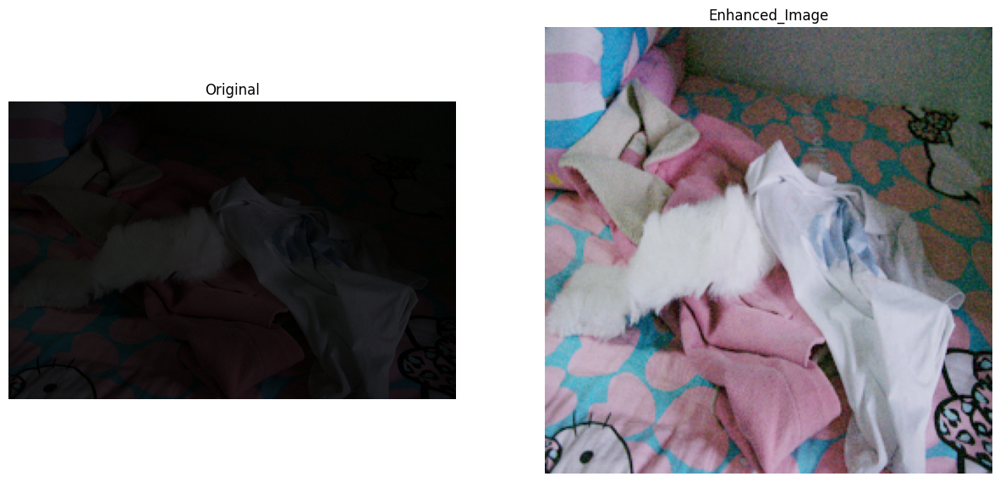

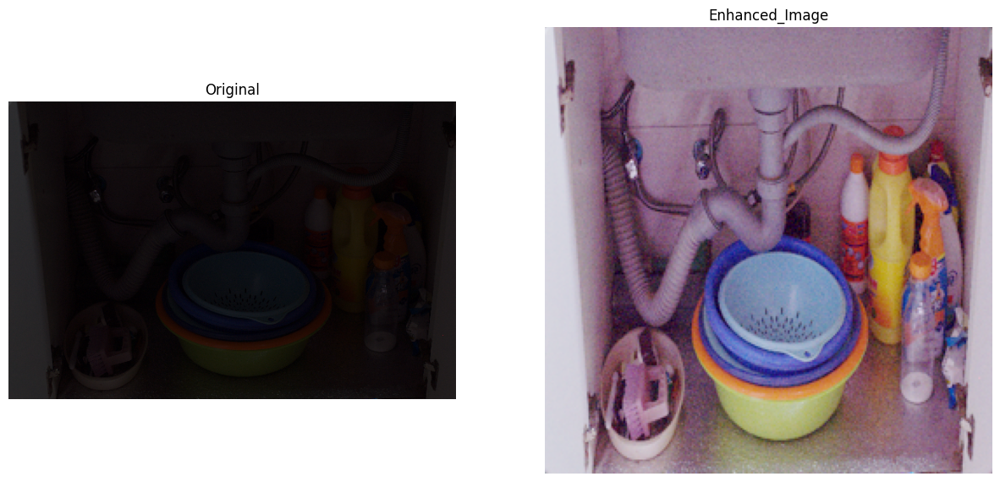

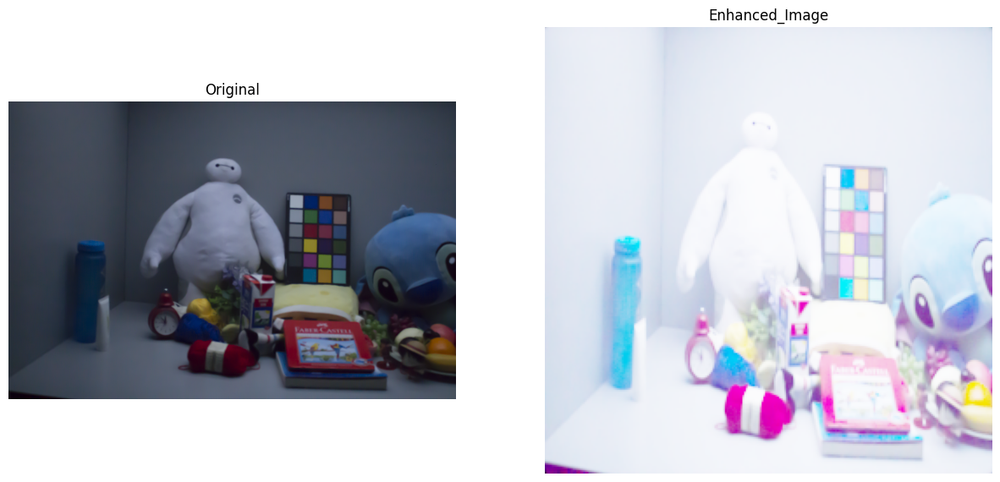

25/25 [==============================] - 114s 5s/step - total_loss: 1.2071 - illumination_smoothness_loss: 0.1382 - spatial_constancy_loss: 0.2784 - color_constancy_loss: 0.0749 - exposure_loss: 0.7156 - val_total_loss: 1.0499 - val_illumination_smoothness_loss: 0.1097 - val_spatial_constancy_loss: 0.3085 - val_color_constancy_loss: 0.0928 - val_exposure_loss: 0.5388
Epoch 22/40
25/25 [==============================] - 115s 5s/step - total_loss: 1.1994 - illumination_smoothness_loss: 0.1311 - spatial_constancy_loss: 0.2794 - color_constancy_loss: 0.0752 - exposure_loss: 0.7138 - val_total_loss: 1.0444 - val_illumination_smoothness_loss: 0.1045 - val_spatial_constancy_loss: 0.3091 - val_color_constancy_loss: 0.0931 - val_exposure_loss: 0.5378
Epoch 23/40
25/25 [==============================] - 115s 5s/step - total_loss: 1.1925 - illumination_smoothness_loss: 0.1247 - spatial_constancy_loss: 0.2802 - color_constancy_loss: 0.0754 - exposure_loss: 0.7122 - val_total_loss: 1.0394 - val_ill

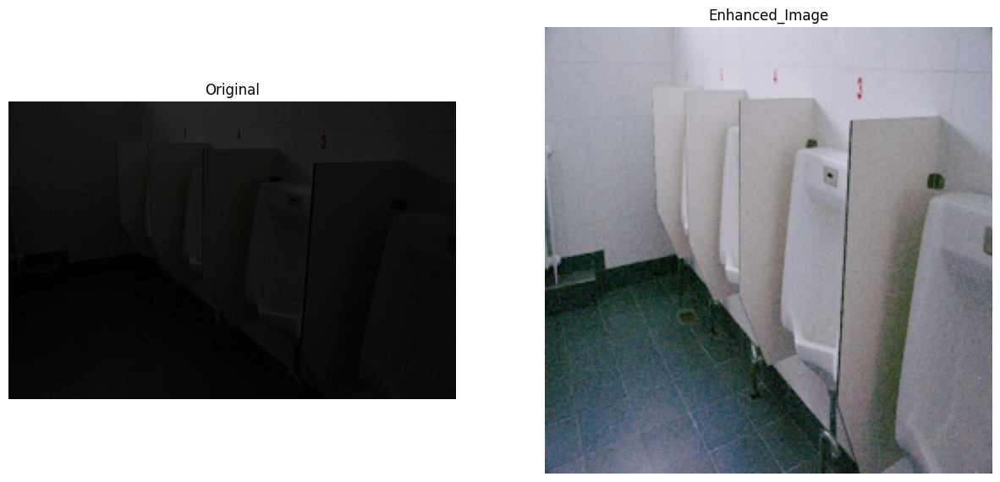

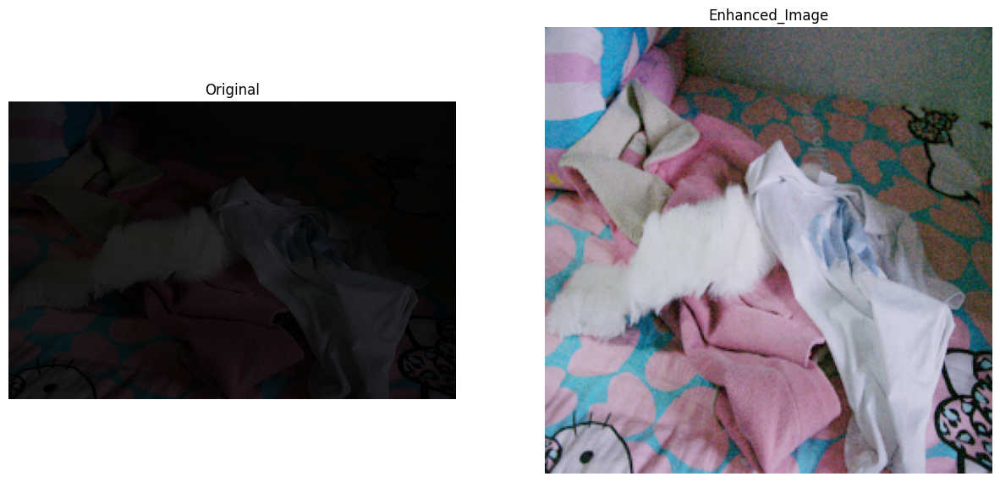

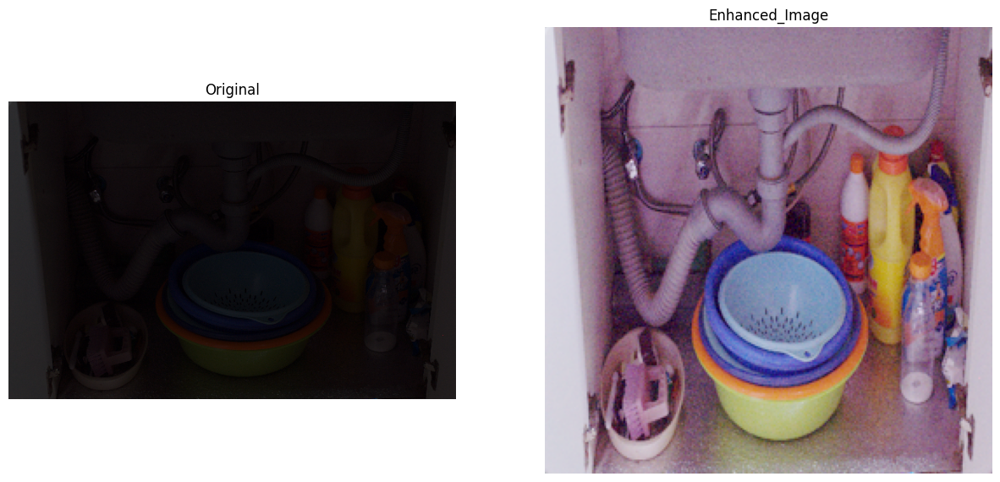

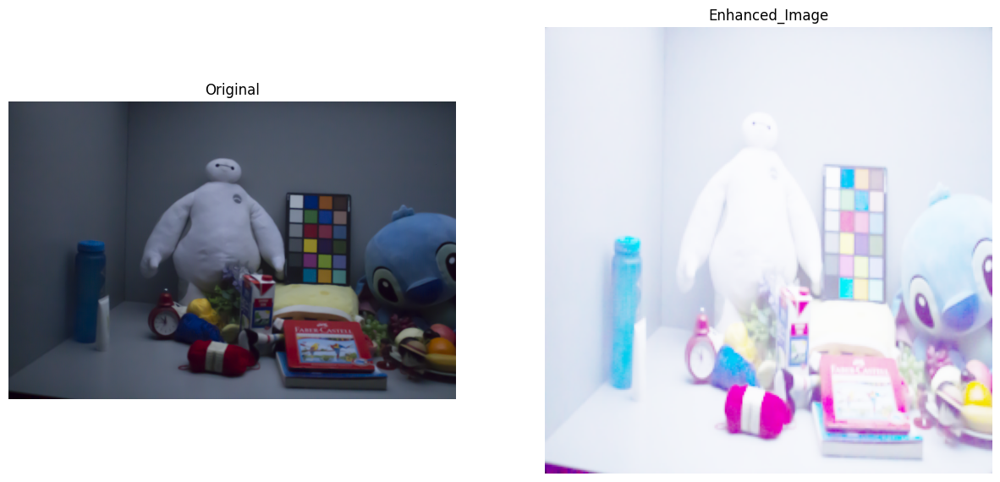

25/25 [==============================] - 115s 5s/step - total_loss: 1.1491 - illumination_smoothness_loss: 0.0839 - spatial_constancy_loss: 0.2858 - color_constancy_loss: 0.0764 - exposure_loss: 0.7030 - val_total_loss: 1.0073 - val_illumination_smoothness_loss: 0.0684 - val_spatial_constancy_loss: 0.3133 - val_color_constancy_loss: 0.0944 - val_exposure_loss: 0.5313
Epoch 32/40
25/25 [==============================] - 112s 4s/step - total_loss: 1.1448 - illumination_smoothness_loss: 0.0798 - spatial_constancy_loss: 0.2864 - color_constancy_loss: 0.0765 - exposure_loss: 0.7021 - val_total_loss: 1.0040 - val_illumination_smoothness_loss: 0.0651 - val_spatial_constancy_loss: 0.3134 - val_color_constancy_loss: 0.0944 - val_exposure_loss: 0.5311
Epoch 33/40
25/25 [==============================] - 112s 4s/step - total_loss: 1.1410 - illumination_smoothness_loss: 0.0762 - spatial_constancy_loss: 0.2869 - color_constancy_loss: 0.0766 - exposure_loss: 0.7012 - val_total_loss: 1.0013 - val_ill

In [54]:
zero_dce_model.compile(learning_rate=LEARNING_RATE)
history = zero_dce_model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=EPOCHS,
    callbacks=[
        LogPredictionCallback(
            image_files=random.sample(val_image_files, 4),
            log_interval=LOG_INTERVALS
        )
    ]
)

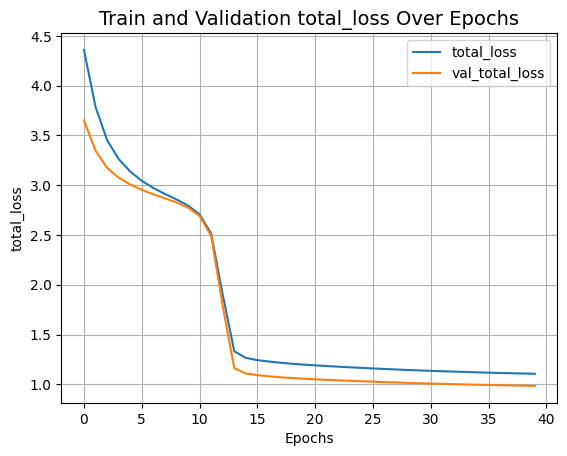

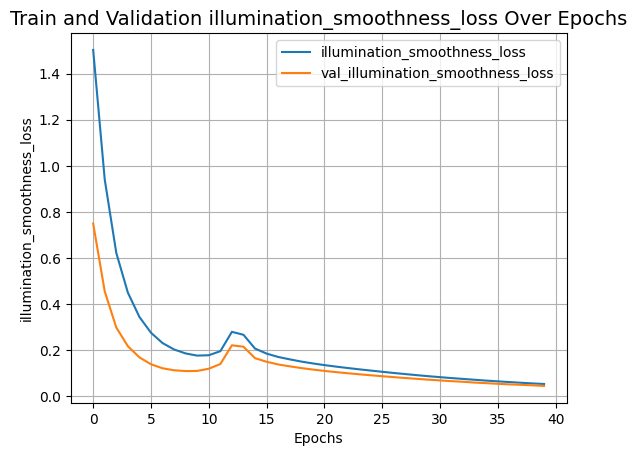

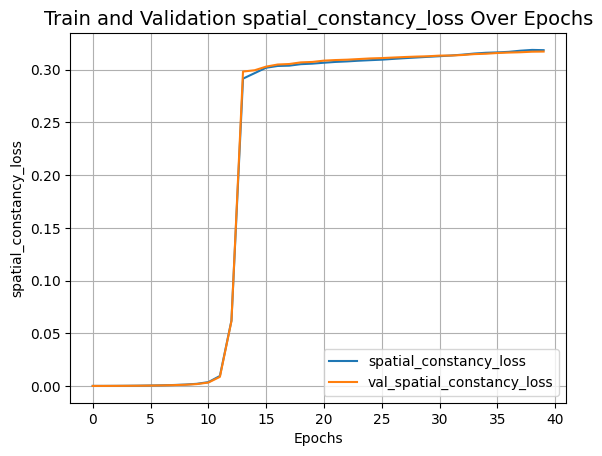

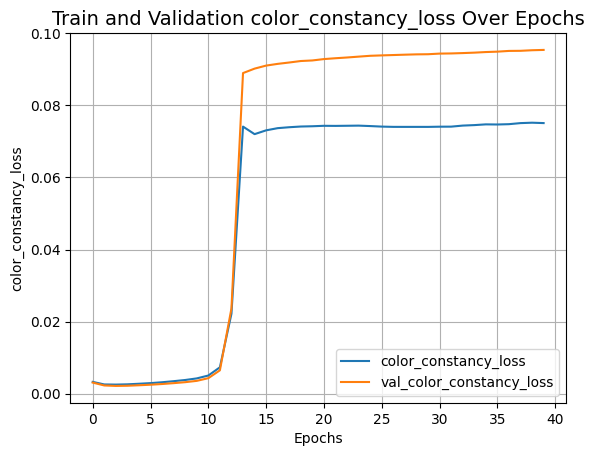

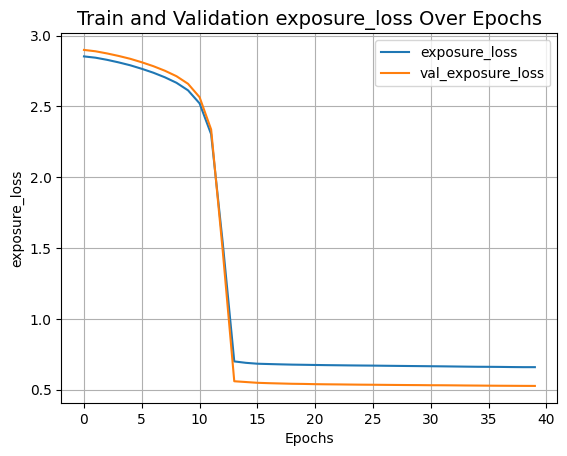

In [ ]:
def plot_result(item):
    plt.plot(history.history[item], label=item)
    plt.plot(history.history["val_" + item], label="val_" + item)
    plt.xlabel("Epochs")
    plt.ylabel(item)
    plt.title("Train and Validation {} Over Epochs".format(item), fontsize=14)
    plt.legend()
    plt.grid()
    plt.show()


plot_result("total_loss")
plot_result("illumination_smoothness_loss")
plot_result("spatial_constancy_loss")
plot_result("color_constancy_loss")
plot_result("exposure_loss")

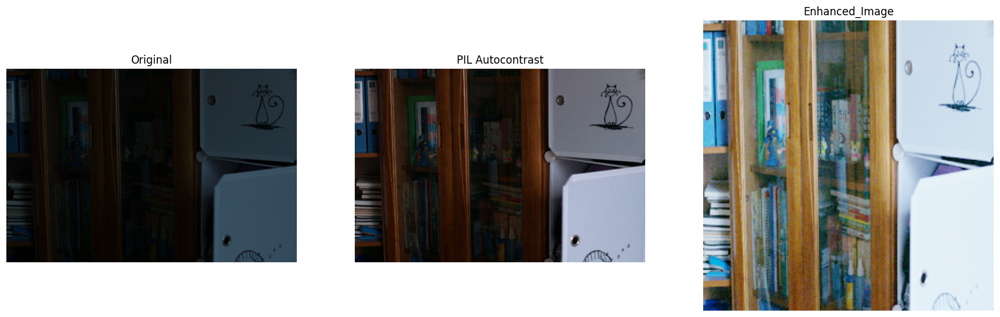

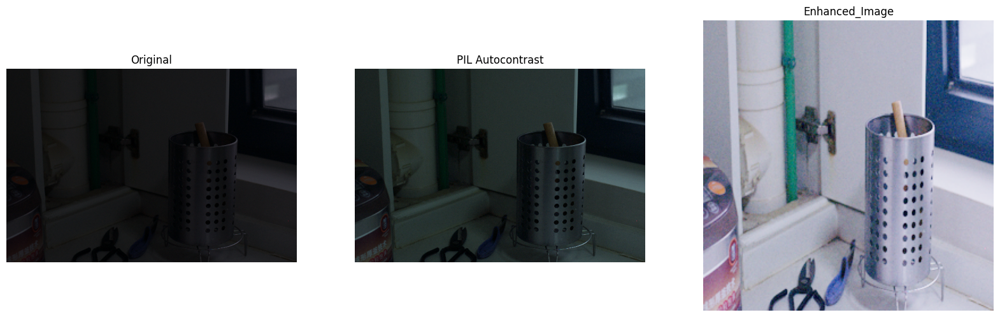

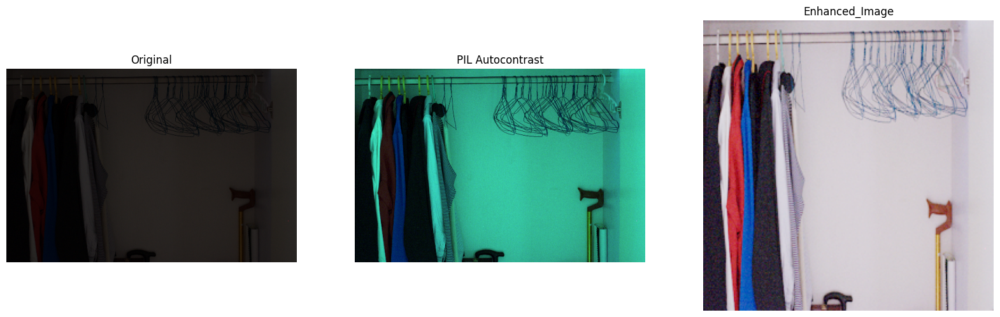

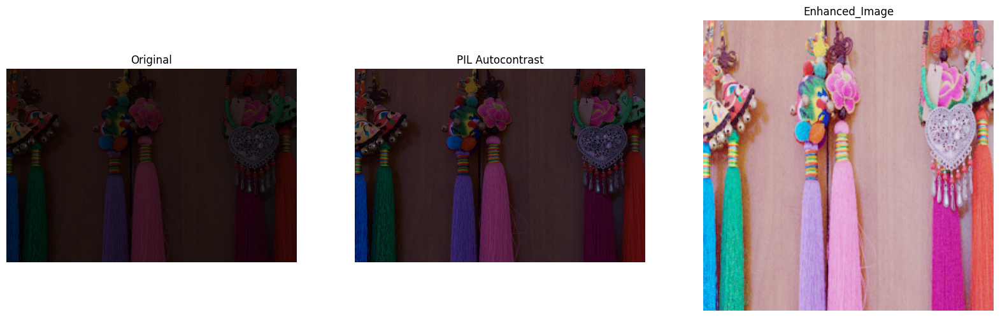

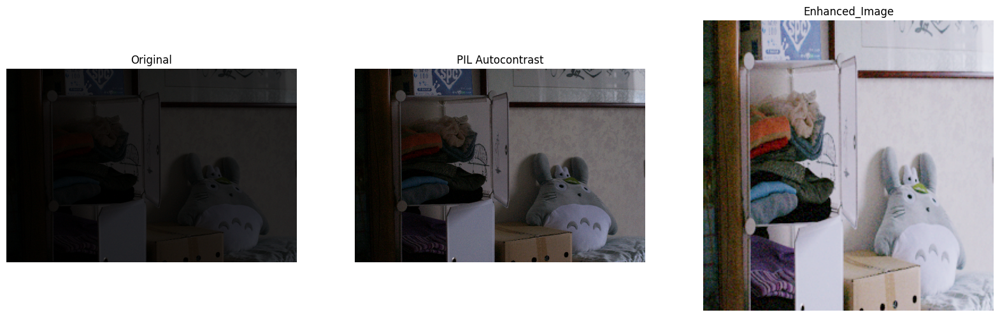

...

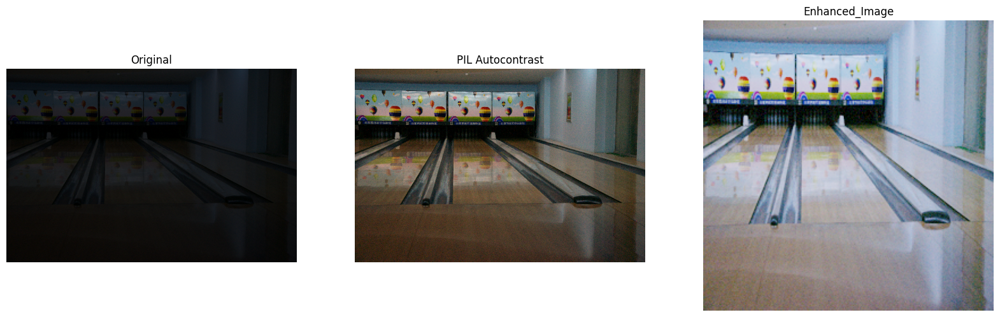

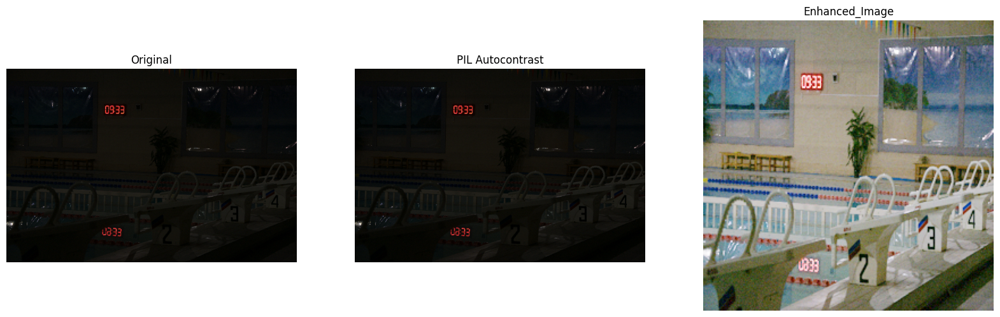

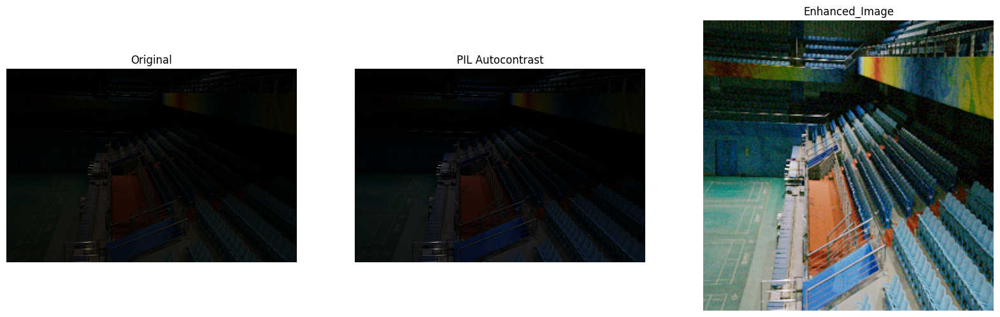

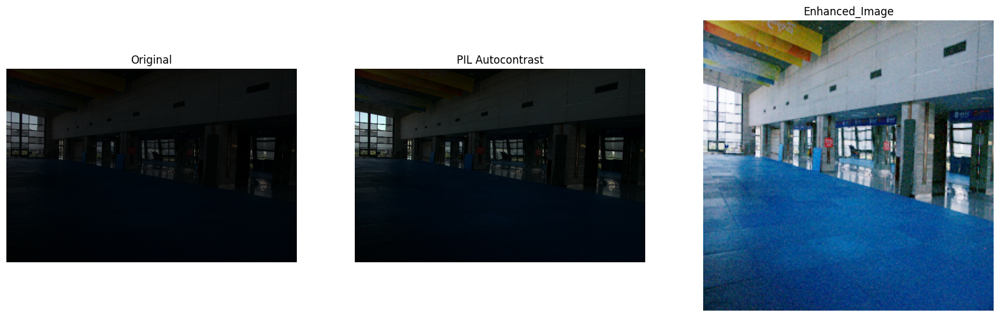

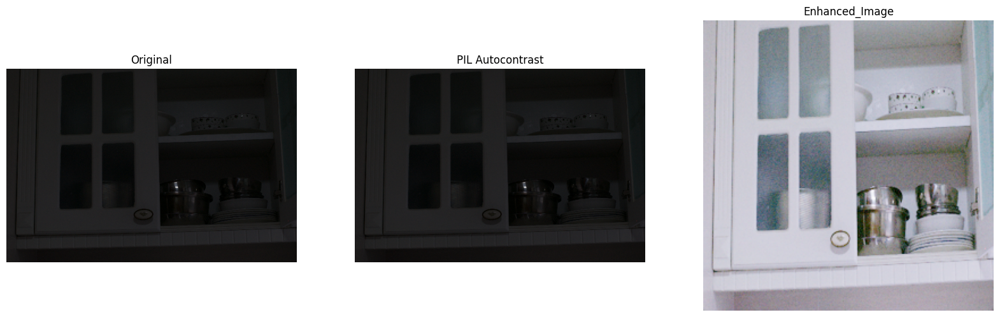

In [57]:
for image_file in test_image_files:
    original_image = Image.open(image_file)
    enhanced_image = infer(original_image)
    plot_results(
        [original_image, ImageOps.autocontrast(original_image), enhanced_image],
        ["Original", "PIL Autocontrast", "Enhanced_Image"],
        (20, 12),
    )

In [58]:
TRAIN_VAL_HIGH_DIR = "data/lol_dataset/our485/high"
TEST_HIGH_DIR = "data/lol_dataset/eval15/high"

train_val_high_files = glob(os.path.join(TRAIN_VAL_HIGH_DIR, "*.png"))
test_high_files = glob(os.path.join(TEST_HIGH_DIR, "*.png"))

random.shuffle(train_val_high_files)

train_high_files = train_val_high_files[:MAX_TRAIN_IMAGES]
val_high_files = train_val_high_files[MAX_TRAIN_IMAGES:]


In [59]:
def calculate_metrics(original, enhanced):
    original = tf.image.convert_image_dtype(original, tf.float32)
    enhanced = tf.image.convert_image_dtype(enhanced, tf.float32)

    psnr = tf.image.psnr(enhanced, original, max_val=1.0)
    ssim = tf.image.ssim(enhanced, original, max_val=1.0)

    mse = tf.reduce_mean(tf.square(original - enhanced))
    mae = tf.reduce_mean(tf.abs(original - enhanced))

    return psnr.numpy().mean(), ssim.numpy().mean(), mse.numpy(), mae.numpy()


In [60]:
psnr_list = []
ssim_list = []
mse_list = []
mae_list = []

for low_path, high_path in zip(test_image_files, test_high_files):

    low_img = Image.open(low_path).convert("RGB")
    high_img = Image.open(high_path).convert("RGB")

    enhanced_img = infer(low_img)

    # Convert to numpy and normalize
    high_np = np.array(high_img.resize((IMAGE_SIZE, IMAGE_SIZE))) / 255.0
    enhanced_np = np.array(enhanced_img) / 255.0

    psnr, ssim, mse, mae = calculate_metrics(
        tf.expand_dims(high_np, 0),
        tf.expand_dims(enhanced_np, 0)
    )

    psnr_list.append(psnr)
    ssim_list.append(ssim)
    mse_list.append(mse)
    mae_list.append(mae)

print("Average PSNR:", np.mean(psnr_list))
print("Average SSIM:", np.mean(ssim_list))
print("Average MSE:", np.mean(mse_list))
print("Average MAE:", np.mean(mae_list))


Average PSNR: 17.630758
Average SSIM: 0.72751045
Average MSE: 0.027251143
Average MAE: 0.13091388
